In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import scipy.stats as stats
from sklearn.preprocessing import StandardScaler

sns.set_style('whitegrid')
plt.style.use('fivethirtyeight')

from ipywidgets import *
from IPython.display import display

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
input_data = pd.read_csv('/home/llevin/Desktop/capstone2/cleaned_data/input_data_vF.csv')

In [3]:
input_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 912 entries, 0 to 911
Data columns (total 84 columns):
away_corners              912 non-null int64
away_fouls                912 non-null int64
away_shots                912 non-null int64
away_shots_target         912 non-null int64
away_yellow_cards         912 non-null int64
away_red_cards            912 non-null int64
away_team                 912 non-null object
full_time_away_goals      912 non-null int64
full_time_home_goals      912 non-null int64
home_corners              912 non-null int64
home_fouls                912 non-null int64
home_red_cards            912 non-null int64
home_yellow_cards         912 non-null int64
home_shots                912 non-null int64
home_shots_target         912 non-null int64
half_time_away_goals      912 non-null int64
half_time_home_goals      912 non-null int64
half_time_result          912 non-null int64
home_team                 912 non-null object
Referee                   672 non-null

In [8]:
num_cols = input_data.select_dtypes(include=['int64','float64']).columns
num_cols = [col for col in num_cols if col not in ['home_team_api_id','away_team_api_id','result']]
home_cols = [col for col in num_cols if 'home' in col]
away_cols = [col for col in num_cols if 'away' in col]

In [17]:
input_cor = input_data[home_cols].corr()

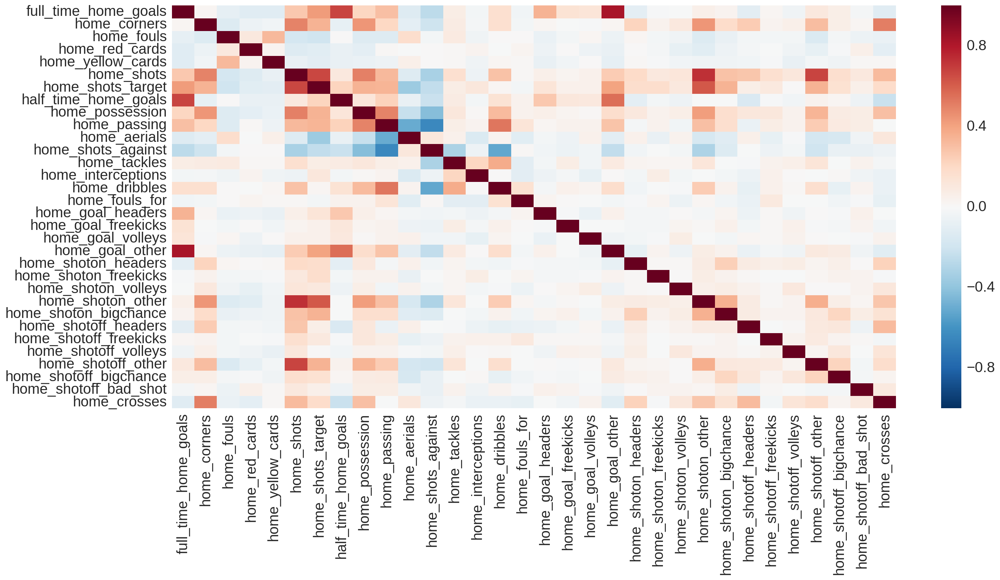

In [18]:
fig, ax = plt.subplots(figsize=(20,10))
sns.set(font_scale=2)
sns.heatmap(data=input_cor, ax=ax)

In [13]:
sns.pairplot(input_data[home_cols])

In [14]:
shot_cols = [col for col in num_cols if 'shot' in col]
shot_cols

['away_shots',
 'away_shots_target',
 'home_shots',
 'home_shots_target',
 'home_shots_against',
 'away_shots_against',
 'home_shoton_headers',
 'home_shoton_freekicks',
 'home_shoton_volleys',
 'home_shoton_other',
 'home_shoton_bigchance',
 'away_shoton_headers',
 'away_shoton_freekicks',
 'away_shoton_volleys',
 'away_shoton_other',
 'away_shoton_bigchance',
 'home_shotoff_headers',
 'home_shotoff_freekicks',
 'home_shotoff_volleys',
 'home_shotoff_other',
 'home_shotoff_bigchance',
 'home_shotoff_bad_shot',
 'away_shotoff_headers',
 'away_shotoff_freekicks',
 'away_shotoff_volleys',
 'away_shotoff_other',
 'away_shotoff_bigchance',
 'away_shotoff_bad_shot']

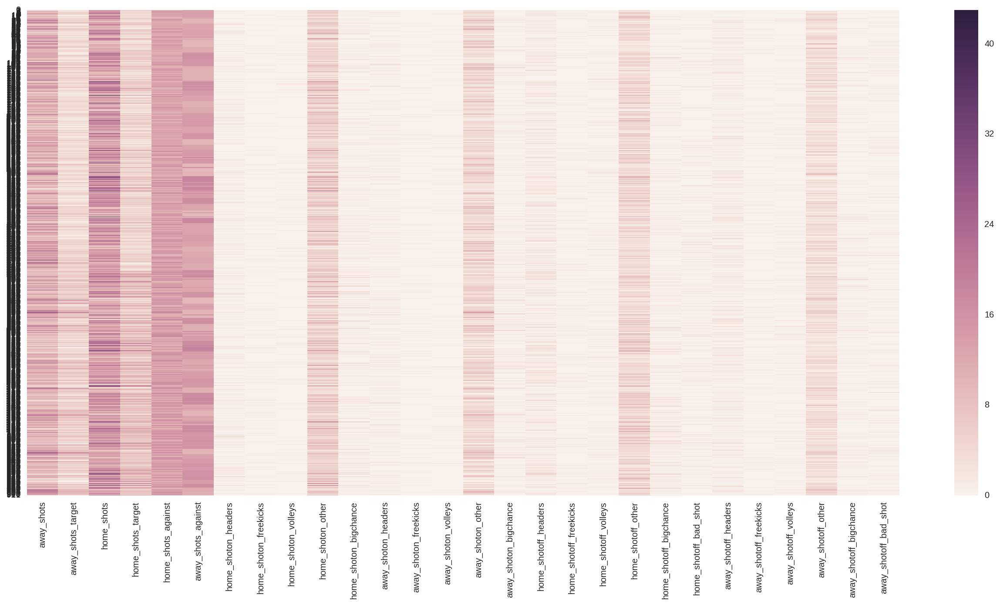

In [16]:
fig, ax = plt.subplots(figsize=(20,10))
sns.heatmap(input_data[shot_cols])

In [18]:
input_data.describe().T

,count,mean,std,min,25%,50%,75%,max
away_corners,912.0,4.758772,2.754685,0.0,3.000,4.0,6.00,17.0
away_fouls,912.0,10.871711,3.558510,1.0,8.000,11.0,13.00,24.0
away_shots,912.0,11.296053,4.757577,0.0,8.000,11.0,14.00,30.0
away_shots_target,912.0,4.925439,2.970571,0.0,3.000,4.0,6.00,20.0
away_yellow_cards,912.0,1.792763,1.262406,0.0,1.000,2.0,3.00,7.0
away_red_cards,912.0,0.100877,0.315566,0.0,0.000,0.0,0.00,2.0
full_time_away_goals,912.0,1.169956,1.165106,0.0,0.000,1.0,2.00,6.0
full_time_home_goals,912.0,1.595395,1.369136,0.0,1.000,1.0,2.00,8.0
home_corners,912.0,6.187500,3.183198,0.0,4.000,6.0,8.00,19.0
home_fouls,912.0,10.607456,3.328925,2.0,8.000,11.0,13.00,23.0


In [35]:
scale = StandardScaler()

norm_data = scale.fit_transform(input_data[num_cols])
norm_data = pd.DataFrame(norm_data)
norm_data.columns = input_data[num_cols].columns

In [37]:
norm_data.describe().T

,count,mean,std,min,25%,50%,75%,max
away_corners,912.0,1.256305e-16,1.000549,-1.728468,-0.638816,-0.275599,0.450835,4.446224
away_fouls,912.0,-1.158917e-16,1.000549,-2.775635,-0.807441,0.036071,0.598413,3.691290
away_shots,912.0,1.877153e-16,1.000549,-2.375632,-0.693181,-0.062262,0.568657,3.933559
away_shots_target,912.0,8.117289e-16,1.000549,-1.658988,-0.648527,-0.311707,0.361934,5.077419
away_yellow_cards,912.0,-3.432926e-17,1.000549,-1.420895,-0.628323,0.164250,0.956823,4.127115
away_red_cards,912.0,-4.187683e-17,1.000549,-0.319846,-0.319846,-0.319846,-0.319846,6.021444
full_time_away_goals,912.0,-2.799905e-17,1.000549,-1.004714,-1.004714,-0.145952,0.712810,4.147858
full_time_home_goals,912.0,1.266044e-17,1.000549,-1.165896,-0.435107,-0.435107,0.295681,4.680410
home_corners,912.0,9.215338e-17,1.000549,-1.944866,-0.687579,-0.058935,0.569708,4.027248
home_fouls,912.0,3.343147e-16,1.000549,-2.587075,-0.783702,0.117984,0.719108,3.724729


In [38]:
sns.pairplot(norm_data[shot_cols])

In [4]:
stadium_group = input_data[[col for col in num_cols]]
stadium_group['Stadium'] = input_data['Stadium']
stadium_group = stadium_group.groupby('Stadium').mean().reset_index()

/home/llevin/anaconda2/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [5]:
stadium_group.head()

,Stadium,away_corners,away_fouls,away_shots,away_shots_target,away_yellow_cards,away_red_cards,full_time_away_goals,full_time_home_goals,home_corners,...,home_shotoff_bigchance,home_shotoff_bad_shot,away_shotoff_headers,away_shotoff_freekicks,away_shotoff_volleys,away_shotoff_other,away_shotoff_bigchance,away_shotoff_bad_shot,home_crosses,away_crosses
0,Anfield,4.065217,10.521739,9.695652,3.978261,1.891304,0.043478,0.978261,1.913043,7.282609,...,1.021739,0.739130,0.608696,0.173913,0.239130,2.934783,0.369565,0.391304,21.543478,13.586957
1,Boleyn Ground,5.394737,10.789474,14.631579,5.842105,1.131579,0.157895,1.394737,1.526316,5.815789,...,0.526316,0.342105,0.868421,0.552632,0.210526,4.105263,0.368421,0.315789,25.947368,17.763158
2,Britannia Stadium,4.775510,10.000000,10.755102,4.551020,1.428571,0.040816,0.938776,1.346939,5.653061,...,0.571429,0.408163,0.714286,0.244898,0.326531,3.448980,0.306122,0.489796,24.367347,15.387755
3,Cardiff City Stadium,6.000000,10.545455,16.181818,6.181818,2.000000,0.000000,2.181818,1.090909,5.363636,...,0.454545,0.454545,1.181818,0.090909,0.181818,4.636364,0.272727,0.454545,23.090909,21.636364
4,Carrow Road,5.527778,9.500000,13.027778,6.000000,1.194444,0.111111,1.305556,1.194444,5.638889,...,0.777778,0.638889,0.916667,0.250000,0.333333,4.000000,0.638889,0.361111,21.305556,19.194444


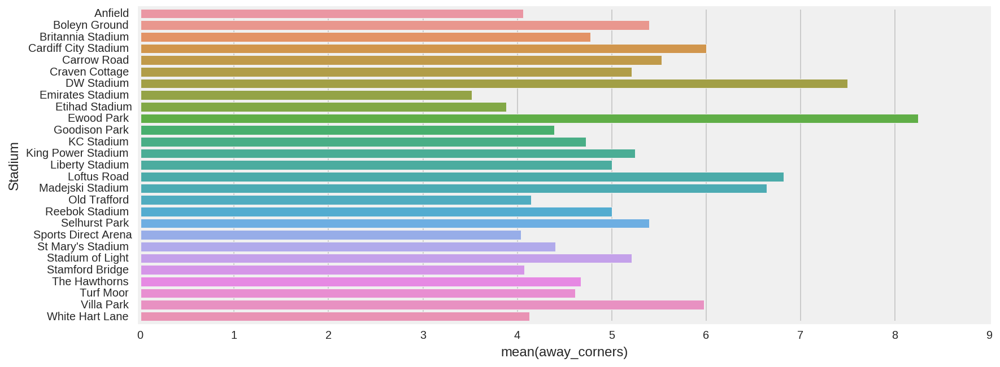

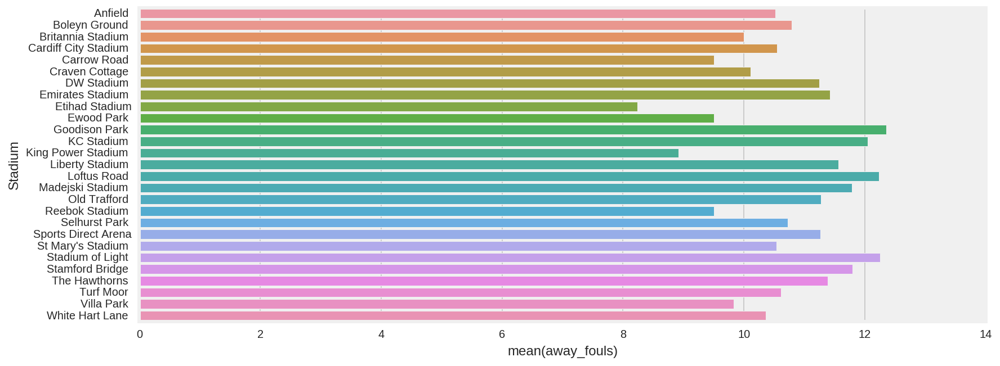

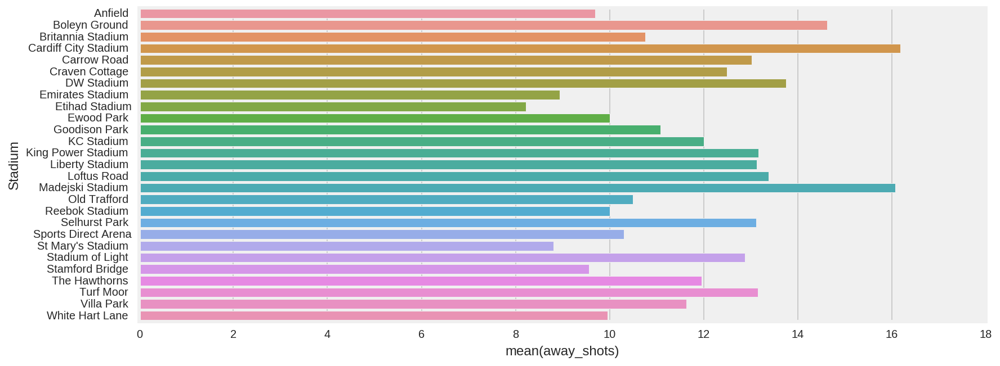

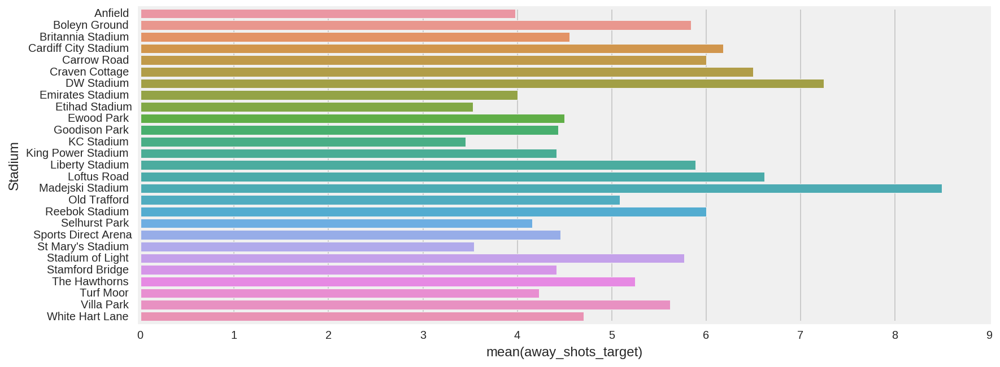

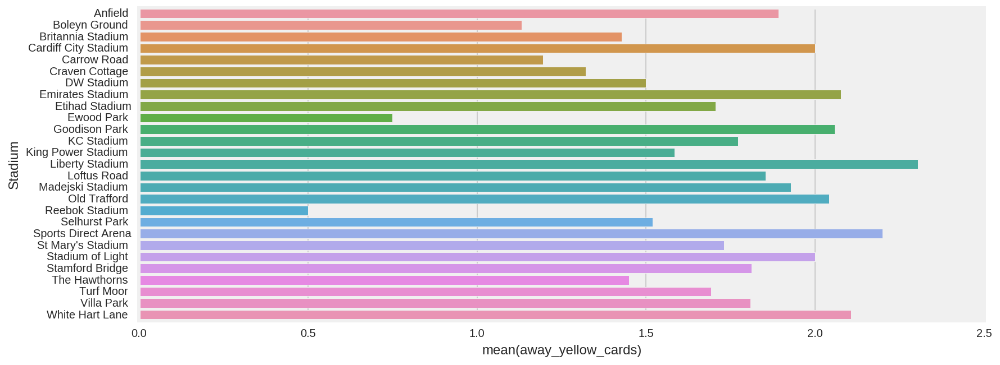

...

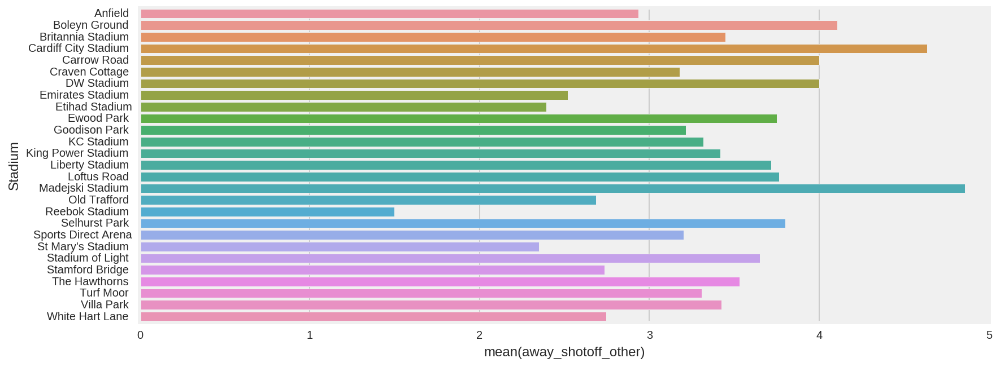

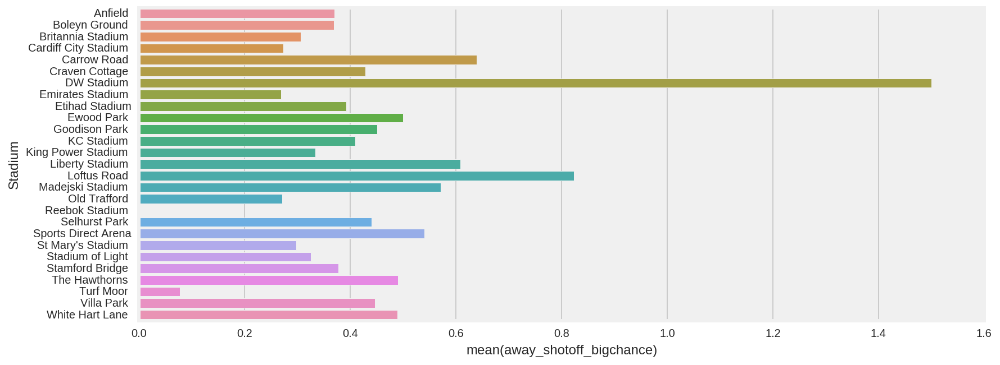

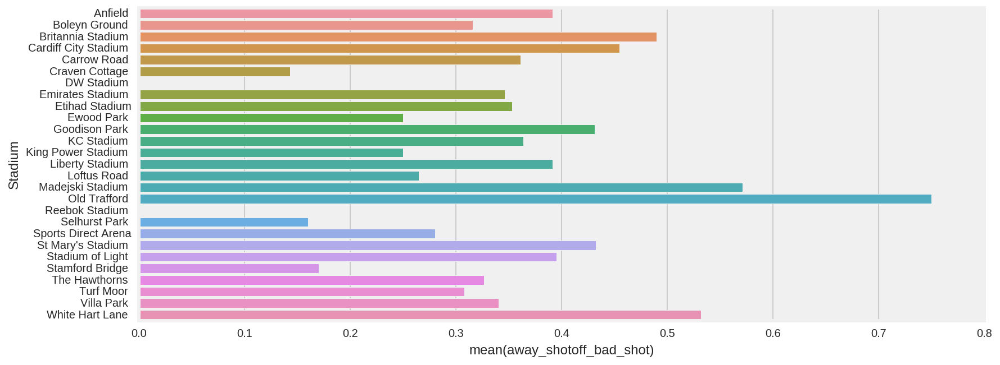

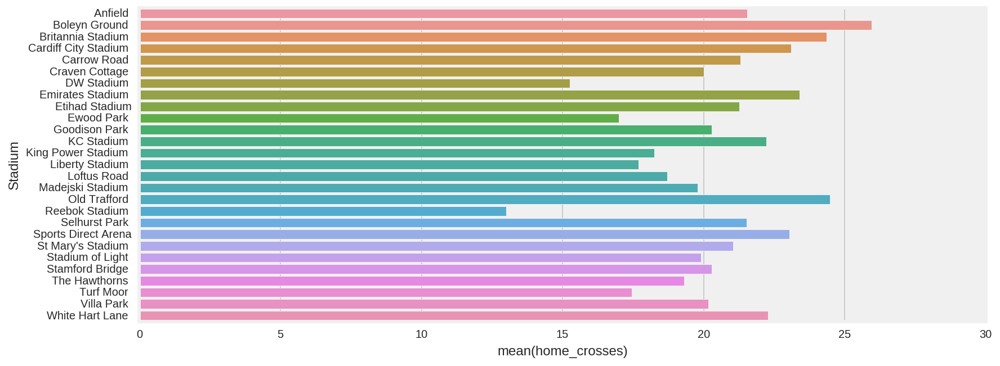

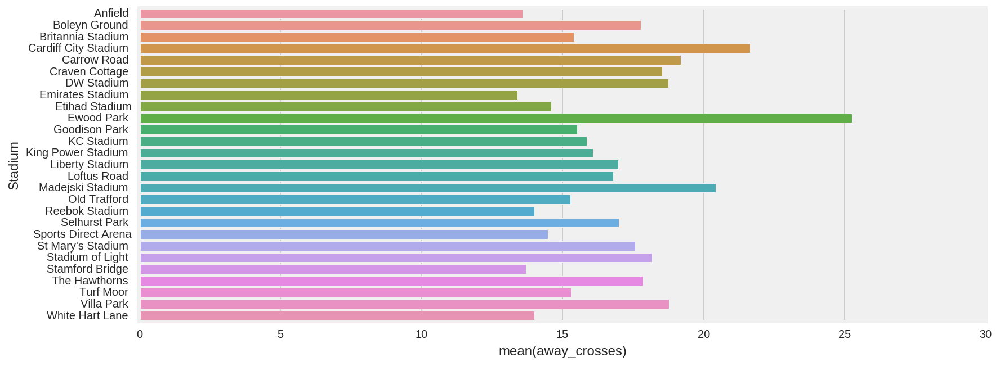

In [30]:
for i in stadium_group.columns:
    if i != 'Stadium':
        fig, ax = plt.subplots(figsize=(12,5))
        sns.barplot(stadium_group[i],stadium_group['Stadium'])

In [38]:
input_data[input_data['Stadium']=='Reebok Stadium ']

,away_corners,away_fouls,away_shots,away_shots_target,away_yellow_cards,away_red_cards,away_team,full_time_away_goals,full_time_home_goals,home_corners,...,home_shotoff_bigchance,home_shotoff_bad_shot,away_shotoff_headers,away_shotoff_freekicks,away_shotoff_volleys,away_shotoff_other,away_shotoff_bigchance,away_shotoff_bad_shot,home_crosses,away_crosses
738,6,8,8,5,0,0,Wolverhampton Wanderers,1,1,3,...,1,1,1,0,1,2,0,0,18,17
850,4,11,12,7,1,0,Newcastle United,2,0,4,...,0,0,2,1,1,1,0,0,8,11


In [39]:
input_data['Stadium'].value_counts()

Stamford Bridge          53
Emirates Stadium         52
Etihad Stadium           51
Goodison Park            51
Sports Direct Arena      50
Britannia Stadium        49
The Hawthorns            49
Old Trafford             48
White Hart Lane          47
Villa Park               47
Anfield                  46
Liberty Stadium          46
Stadium of Light         43
Boleyn Ground            38
St Mary's Stadium        37
Carrow Road              36
Loftus Road              34
Craven Cottage           28
Selhurst Park            25
KC Stadium               22
Madejski Stadium         14
Turf Moor                13
King Power Stadium       12
Cardiff City Stadium     11
Ewood Park                4
DW Stadium                4
Reebok Stadium            2
Name: Stadium, dtype: int64

In [40]:

ref_group.head()

/home/llevin/anaconda2/envs/dsi/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


,Referee,away_corners,away_fouls,away_shots,away_shots_target,away_yellow_cards,away_red_cards,full_time_away_goals,full_time_home_goals,home_corners,...,home_shotoff_bigchance,home_shotoff_bad_shot,away_shotoff_headers,away_shotoff_freekicks,away_shotoff_volleys,away_shotoff_other,away_shotoff_bigchance,away_shotoff_bad_shot,home_crosses,away_crosses
0,A Marriner,4.815789,9.868421,12.342105,4.631579,1.842105,0.105263,1.342105,1.973684,6.342105,...,0.552632,0.421053,0.815789,0.184211,0.342105,3.552632,0.289474,0.368421,21.315789,15.710526
1,A Taylor,4.421053,9.500000,11.894737,4.026316,1.605263,0.131579,1.131579,1.684211,6.210526,...,0.421053,0.447368,0.947368,0.052632,0.289474,3.684211,0.657895,0.342105,21.605263,14.578947
2,C Foy,4.864865,10.243243,12.918919,5.189189,1.486486,0.243243,0.972973,1.432432,5.567568,...,0.702703,0.405405,0.756757,0.243243,0.270270,3.837838,0.486486,0.405405,18.648649,17.135135
3,C Pawson,5.631579,11.473684,12.210526,3.263158,1.578947,0.052632,0.842105,1.789474,5.263158,...,0.894737,0.263158,0.947368,0.210526,0.473684,3.421053,0.684211,0.263158,18.105263,17.736842
4,G Scott,5.000000,8.000000,18.000000,7.000000,4.000000,0.000000,1.000000,1.000000,1.000000,...,1.000000,0.000000,1.000000,1.000000,0.000000,2.000000,0.000000,0.000000,19.000000,16.000000


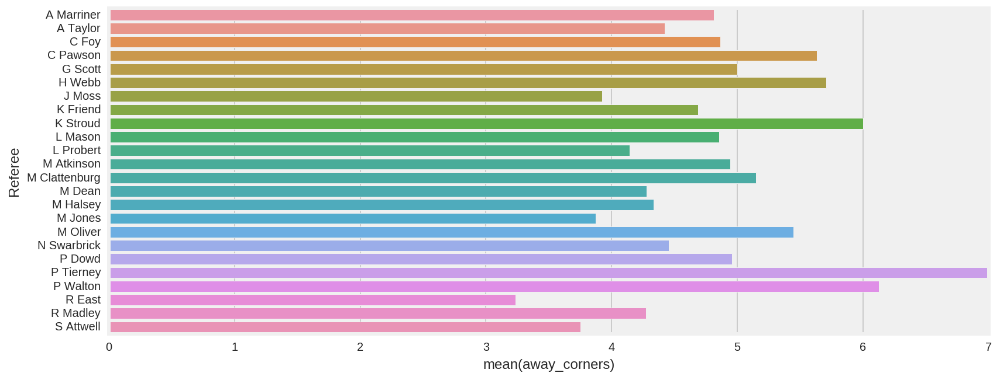

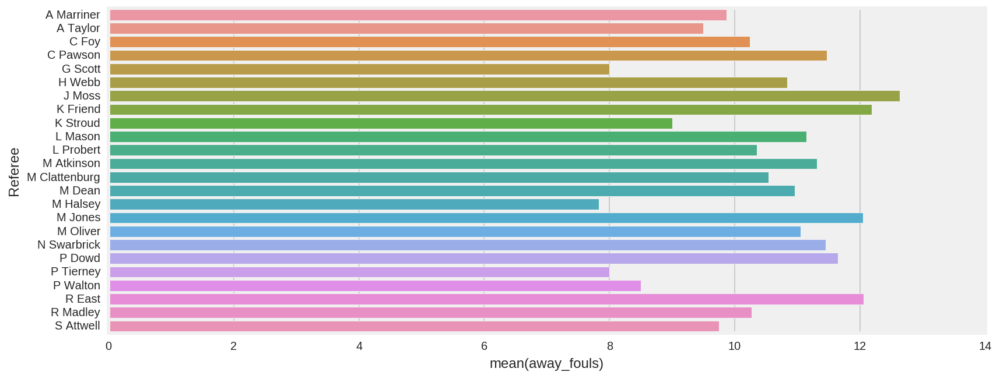

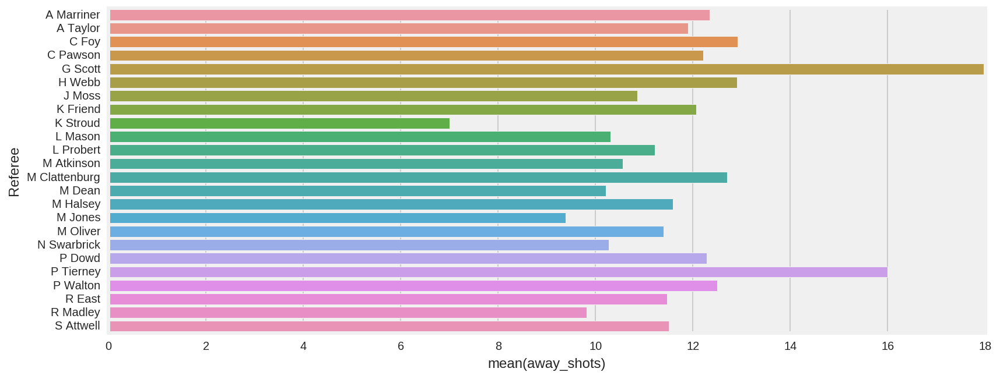

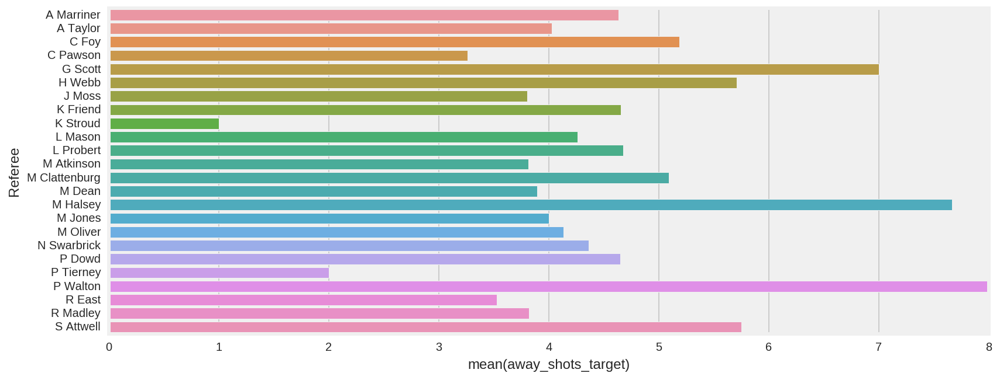

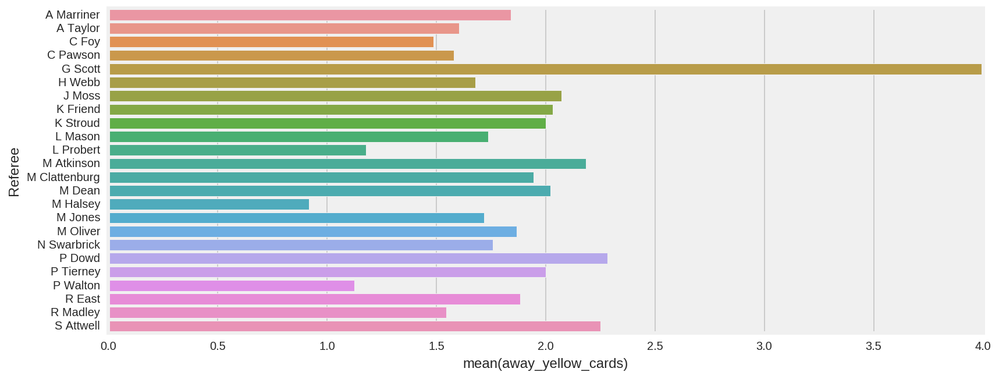

...

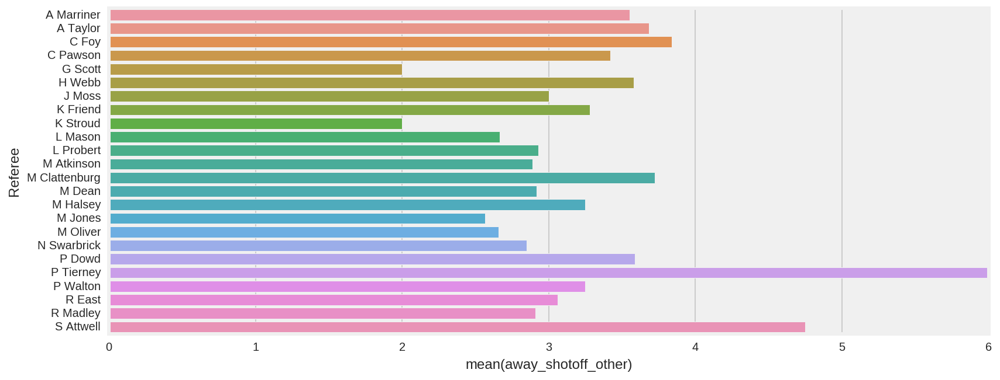

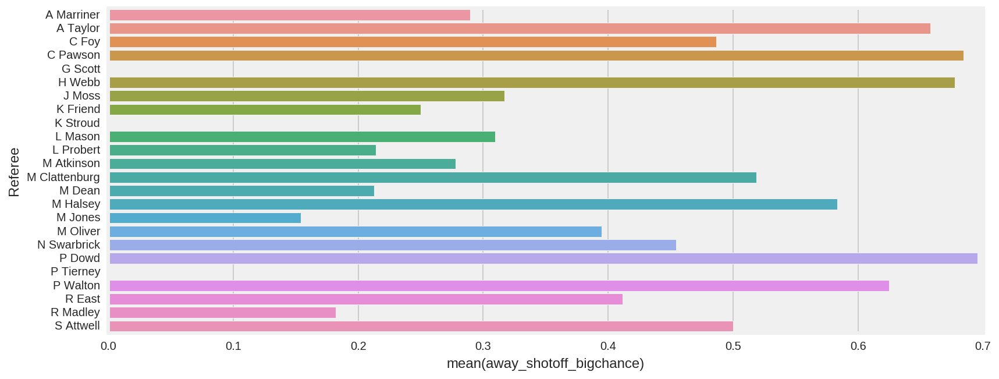

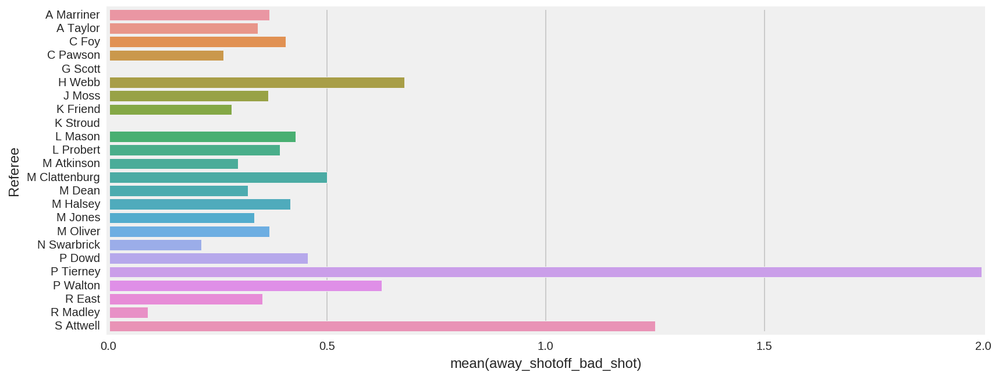

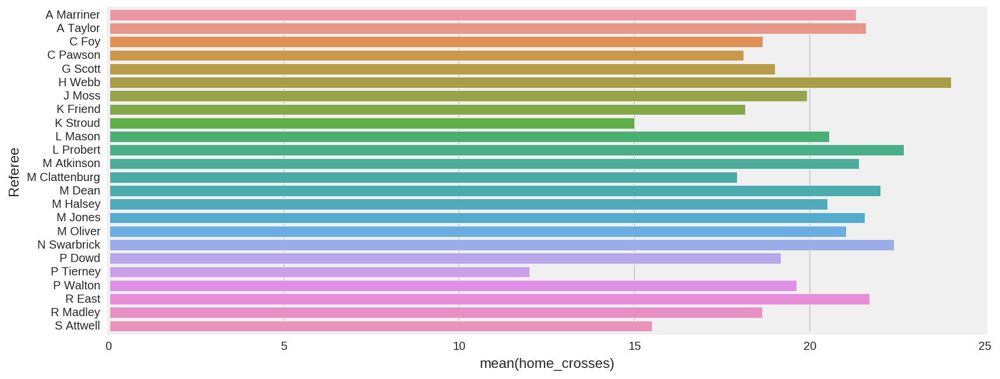

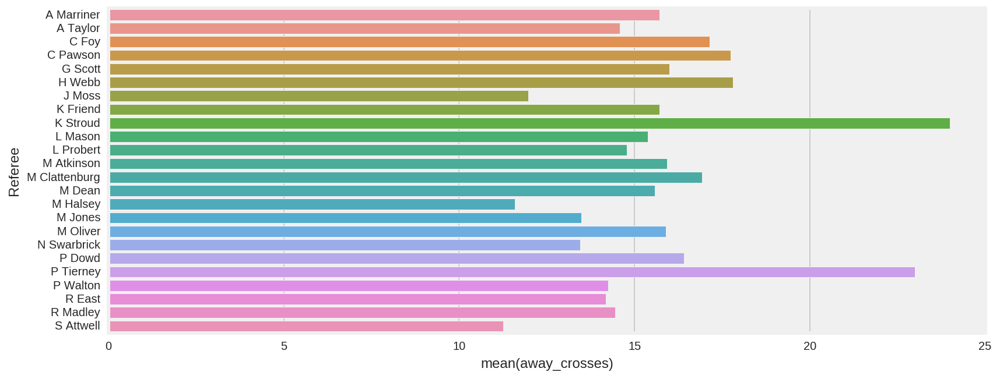

In [41]:
for i in ref_group.columns:
    if i != 'Referee':
        fig, ax = plt.subplots(figsize=(12,5))
        sns.barplot(ref_group[i],ref_group['Referee'])

In [42]:
input_data['Referee'].value_counts()

M Clattenburg    54
M Atkinson       54
M Dean           47
P Dowd           46
L Mason          42
J Moss           41
M Jones          39
M Oliver         38
A Taylor         38
A Marriner       38
C Foy            37
N Swarbrick      33
K Friend         32
H Webb           31
L Probert        28
C Pawson         19
R East           17
M Halsey         12
R Madley         11
P Walton          8
S Attwell         4
K Stroud          1
G Scott           1
P Tierney         1
Name: Referee, dtype: int64